In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data = pd.read_csv('survey_results_public.csv')
schema=pd.read_csv('survey_results_schema.csv')
data.head()

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,...,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary
0,1,Student,"Yes, both",United States,No,"Not employed, and not looking for work",Secondary school,NaN,NaN,NaN,...,Strongly disagree,Male,High school,White or of European descent,Strongly disagree,Strongly agree,Disagree,Strongly agree,NaN,NaN
1,2,Student,"Yes, both",United Kingdom,"Yes, full-time",Employed part-time,Some college/university study without earning ...,Computer science or software engineering,"More than half, but not all, the time",20 to 99 employees,...,Strongly disagree,Male,A master's degree,White or of European descent,Somewhat agree,Somewhat agree,Disagree,Strongly agree,NaN,37500.0
2,3,Professional developer,"Yes, both",United Kingdom,No,Employed full-time,Bachelor's degree,Computer science or software engineering,"Less than half the time, but at least one day ...","10,000 or more employees",...,Disagree,Male,A professional degree,White or of European descent,Somewhat agree,Agree,Disagree,Agree,113750.0,NaN
3,4,Professional non-developer who sometimes write...,"Yes, both",United States,No,Employed full-time,Doctoral degree,A non-computer-focused engineering discipline,"Less than half the time, but at least one day ...","10,000 or more employees",...,Disagree,Male,A doctoral degree,White or of European descent,Agree,Agree,Somewhat agree,Strongly agree,NaN,NaN
4,5,Professional developer,"Yes, I program as a hobby",Switzerland,No,Employed full-time,Master's degree,Computer science or software engineering,Never,10 to 19 employees,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
data.dtypes

Respondent                int64
Professional             object
ProgramHobby             object
Country                  object
University               object
                         ...   
QuestionsInteresting     object
QuestionsConfusing       object
InterestedAnswers        object
Salary                  float64
ExpectedSalary          float64
Length: 154, dtype: object

In [4]:
entries = len(data.index)
nansum = {}
for col in data.columns:
    nansum[col] = data[col].isna().sum()

In [5]:
nan_frame = pd.DataFrame.from_dict(data=nansum, orient='index')
nan_frame.rename(columns={0:'NaN Count'}, inplace=True)

In [6]:
nan_frame['percentage'] = nan_frame['NaN Count'].apply(lambda x: x/entries * 100)

In [7]:
nan_frame['type'] = nan_frame['NaN Count'].apply(lambda x: x/entries * 100)

In [8]:
nan_frame

,NaN Count,percentage,type
Respondent,0,0.000000,0.000000
Professional,0,0.000000,0.000000
ProgramHobby,0,0.000000,0.000000
Country,0,0.000000,0.000000
University,0,0.000000,0.000000
...,...,...,...
QuestionsInteresting,16856,32.798879,32.798879
QuestionsConfusing,16973,33.026541,33.026541
InterestedAnswers,16780,32.650996,32.650996
Salary,38501,74.916329,74.916329


<AxesSubplot:>

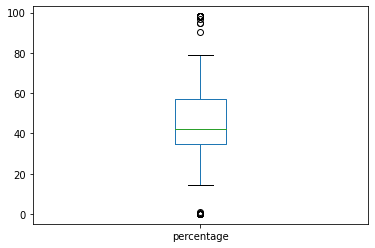

In [9]:
nan_frame['percentage'].plot.box()

<AxesSubplot:ylabel='Frequency'>

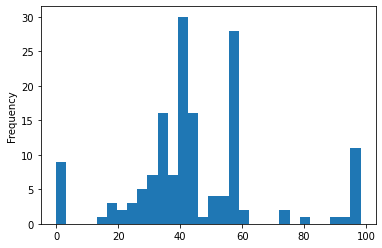

In [10]:
nan_frame['percentage'].plot.hist(bins=30)

In [11]:
nan_frame[nan_frame['percentage'] > 60]

,NaN Count,percentage,type
YearsCodedJobPast,50418,98.104763,98.104763
WebDeveloperType,40696,79.187422,79.187422
MobileDeveloperType,49839,96.978129,96.978129
NonDeveloperType,46502,90.484900,90.484900
ExCoderReturn,50469,98.204001,98.204001
ExCoderNotForMe,50471,98.207892,98.207892
ExCoderBalance,50469,98.204001,98.204001
ExCoder10Years,50475,98.215676,98.215676
ExCoderBelonged,50464,98.194271,98.194271
ExCoderSkills,50457,98.180651,98.180651


In [12]:
#pd.set_option('display.max_columns', None)
#pd.set_option("max_rows", None)
nan_frame

,NaN Count,percentage,type
Respondent,0,0.000000,0.000000
Professional,0,0.000000,0.000000
ProgramHobby,0,0.000000,0.000000
Country,0,0.000000,0.000000
University,0,0.000000,0.000000
...,...,...,...
QuestionsInteresting,16856,32.798879,32.798879
QuestionsConfusing,16973,33.026541,33.026541
InterestedAnswers,16780,32.650996,32.650996
Salary,38501,74.916329,74.916329


In [13]:
data['JobSatisfaction'].unique()

array([nan,  9.,  3.,  8.,  6.,  7.,  5.,  4., 10.,  2.,  0.,  1.])

In [14]:
%matplotlib notebook
# pd.reset_option(“max_columns”)
pd.set_option('display.max_columns', None)
pd.set_option("max_rows", None)
data[data['YearsCodedJobPast'].notna()]

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,CompanyType,YearsProgram,YearsCodedJob,YearsCodedJobPast,DeveloperType,WebDeveloperType,MobileDeveloperType,NonDeveloperType,CareerSatisfaction,JobSatisfaction,ExCoderReturn,ExCoderNotForMe,ExCoderBalance,ExCoder10Years,ExCoderBelonged,ExCoderSkills,ExCoderWillNotCode,ExCoderActive,PronounceGIF,ProblemSolving,BuildingThings,LearningNewTech,BoringDetails,JobSecurity,DiversityImportant,AnnoyingUI,FriendsDevelopers,RightWrongWay,UnderstandComputers,SeriousWork,InvestTimeTools,WorkPayCare,KinshipDevelopers,ChallengeMyself,CompetePeers,ChangeWorld,JobSeekingStatus,HoursPerWeek,LastNewJob,AssessJobIndustry,AssessJobRole,AssessJobExp,AssessJobDept,AssessJobTech,AssessJobProjects,AssessJobCompensation,AssessJobOffice,AssessJobCommute,AssessJobRemote,AssessJobLeaders,AssessJobProfDevel,AssessJobDiversity,AssessJobProduct,AssessJobFinances,ImportantBenefits,ClickyKeys,JobProfile,ResumePrompted,LearnedHiring,ImportantHiringAlgorithms,ImportantHiringTechExp,ImportantHiringCommunication,ImportantHiringOpenSource,ImportantHiringPMExp,ImportantHiringCompanies,ImportantHiringTitles,ImportantHiringEducation,ImportantHiringRep,ImportantHiringGettingThingsDone,Currency,Overpaid,TabsSpaces,EducationImportant,EducationTypes,SelfTaughtTypes,TimeAfterBootcamp,CousinEducation,WorkStart,HaveWorkedLanguage,WantWorkLanguage,HaveWorkedFramework,WantWorkFramework,HaveWorkedDatabase,WantWorkDatabase,HaveWorkedPlatform,WantWorkPlatform,IDE,AuditoryEnvironment,Methodology,VersionControl,CheckInCode,ShipIt,OtherPeoplesCode,ProjectManagement,EnjoyDebugging,InTheZone,DifficultCommunication,CollaborateRemote,MetricAssess,EquipmentSatisfiedMonitors,EquipmentSatisfiedCPU,EquipmentSatisfiedRAM,EquipmentSatisfiedStorage,EquipmentSatisfiedRW,InfluenceInternet,InfluenceWorkstation,InfluenceHardware,InfluenceServers,InfluenceTechStack,InfluenceDeptTech,InfluenceVizTools,InfluenceDatabase,InfluenceCloud,InfluenceConsultants,InfluenceRecruitment,InfluenceCommunication,StackOverflowDescribes,StackOverflowSatisfaction,StackOverflowDevices,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowJobListing,StackOverflowCompanyPage,StackOverflowJobSearch,StackOverflowNewQuestion,StackOverflowAnswer,StackOverflowMetaChat,StackOverflowAdsRelevant,StackOverflowAdsDistracting,StackOverflowModeration,StackOverflowCommunity,StackOverflowHelpful,StackOverflowBetter,StackOverflowWhatDo,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary
12,13,Used to be a professional developer,"Yes, I program as a hobby",United Kingdom,No,"Not employed, but looking for work",Bachelor's degree,Mathematics or statistics,NaN,NaN,NaN,20 or more years,NaN,17 to 18 years,NaN,NaN,NaN,NaN,3.0,NaN,Agree,Strongly disagree,Disagree,Strongly disagree,Disagree,Strongly disagree,Disagree,Somewhat agree,"With a hard ""g,"" like ""gift""",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I am actively looking for a job,1.0,More than 4 years ago,Important,Somewhat important,Important,Important,Very important,Important,Important,Very important,Somewhat important,Not at all important,Not very important,Important,Not very important,Not very important,Somewhat important,Retirement; Vacation/days off; Equipment; Prof...,No,LinkedIn,NaN,NaN,Important,Somewhat important,Not at all important,Not at all important,Not at all important,Not very important,Not at all important,Important,Not very important,Very important,NaN,NaN,Spaces,NaN,NaN,NaN,NaN,NaN,10:00 AM,C; C++; Java,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Turn on some music,NaN,Zip file back-ups,Never,Agree,Agree,Agree,Somewhat agree,Strongly agree,Disagree,Strongly agree,Customer satisfaction; Benchmarked product per...,Very satisfied,Very satisfied,Very satisfied,Very satisfied,Very satisfied,Very satisfied,NaN,NaN,NaN,NaN,NaN,Na

In [15]:
data['YearsCodedJob'].unique()

array([nan, '20 or more years', '9 to 10 years', '10 to 11 years',
       '8 to 9 years', '7 to 8 years', '11 to 12 years', '15 to 16 years',
       '1 to 2 years', '3 to 4 years', '12 to 13 years',
       'Less than a year', '5 to 6 years', '16 to 17 years',
       '13 to 14 years', '6 to 7 years', '2 to 3 years', '17 to 18 years',
       '4 to 5 years', '14 to 15 years', '18 to 19 years',
       '19 to 20 years'], dtype=object)

In [16]:
import math
ind = 2
categorysample = data['YearsCodedJob'].loc[ind]
print(data['YearsCodedJob'].loc[ind])
if pd.isnull(categorysample):
    x = None
else:
    x = categorysample.split()[0]
print(x)

20 or more years
20


In [17]:
data['MinYearsCodedJob'] = data['YearsCodedJob'].apply(lambda x: x.split()[0] if not pd.isnull(x) else None)
data['MinYearsCodedJob'] = data['MinYearsCodedJob'].apply(lambda x: None if x == 'Less' else x)
data[['MinYearsCodedJob', 'YearsCodedJob']]

,MinYearsCodedJob,YearsCodedJob
0,None,NaN
1,None,NaN
2,20,20 or more years
3,9,9 to 10 years
4,10,10 to 11 years
5,None,NaN
6,8,8 to 9 years
7,7,7 to 8 years
8,7,7 to 8 years
9,8,8 to 9 years


<AxesSubplot:>

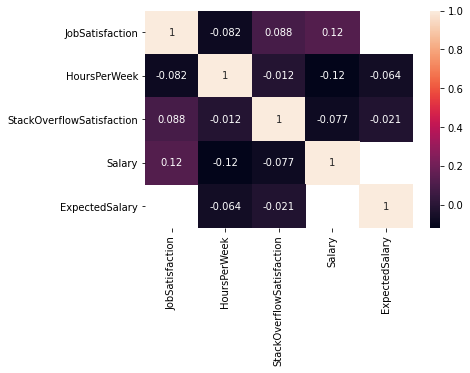

In [48]:
cols = ['JobSatisfaction',
'HoursPerWeek',
'StackOverflowSatisfaction',
'Salary',
'ExpectedSalary']
%matplotlib inline
sns.heatmap(data[cols].corr(), annot=data[cols].corr())

In [49]:
data['HoursPerWeek'].unique()

array([ 0., nan,  5.,  1.,  2.,  3.,  4., 10.,  6.,  7., 40., 21.,  8.,
       30., 19., 20., 12.,  9., 15., 25., 22., 11., 35., 14., 38., 32.,
       34., 16., 24., 13., 37., 18., 26., 39., 23., 28., 27., 17., 29.,
       36., 33., 31.])

<AxesSubplot:xlabel='HoursPerWeek', ylabel='Salary'>

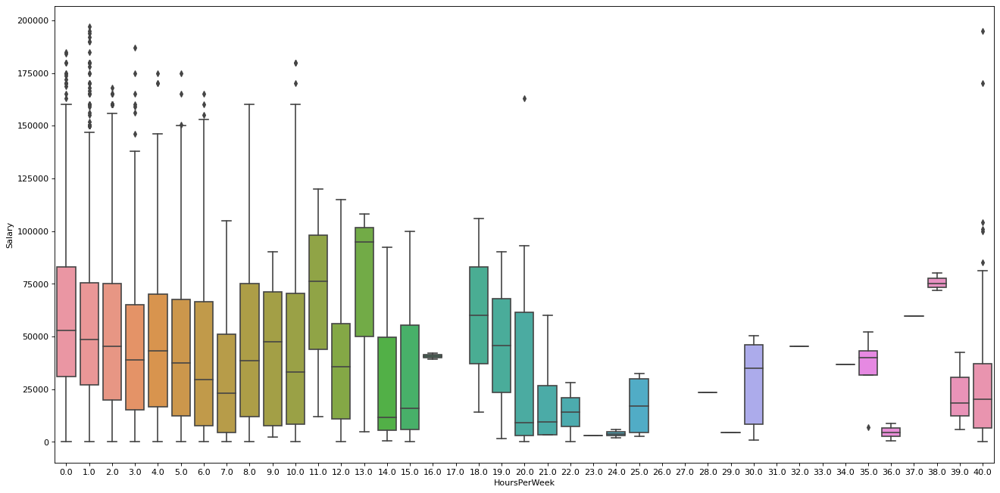

In [50]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['HoursPerWeek'], y=data['Salary'])

<AxesSubplot:xlabel='HoursPerWeek', ylabel='JobSatisfaction'>

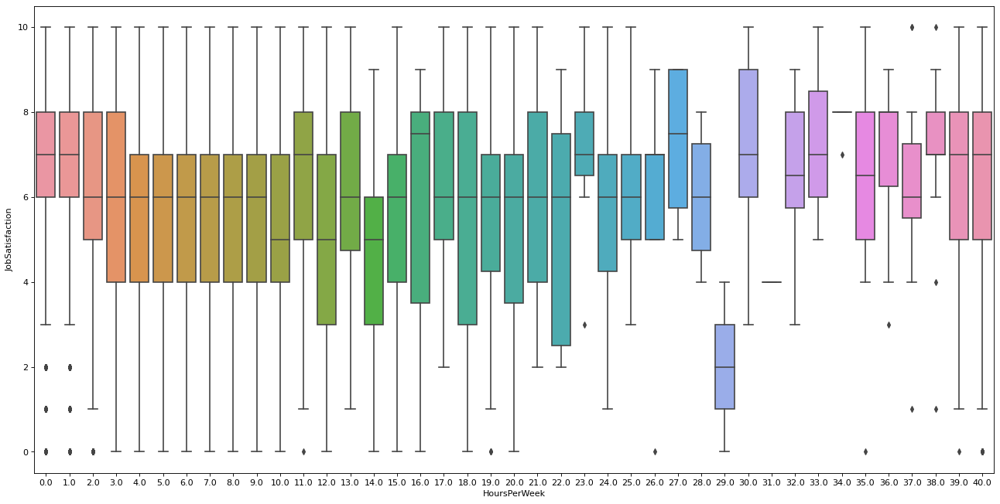

In [51]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['HoursPerWeek'], y=data['JobSatisfaction'])

<AxesSubplot:xlabel='StackOverflowSatisfaction', ylabel='Salary'>

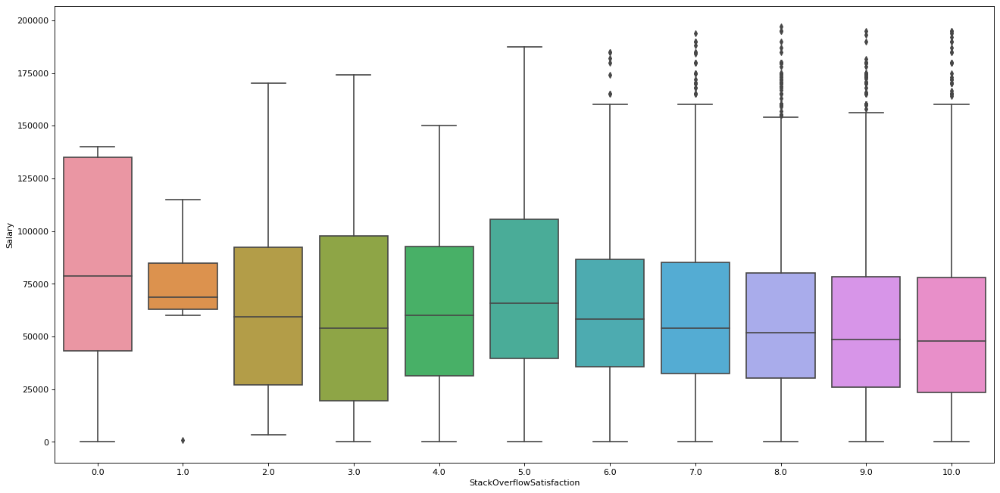

In [52]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['StackOverflowSatisfaction'], y=data['Salary'])

<AxesSubplot:xlabel='JobSatisfaction', ylabel='Salary'>

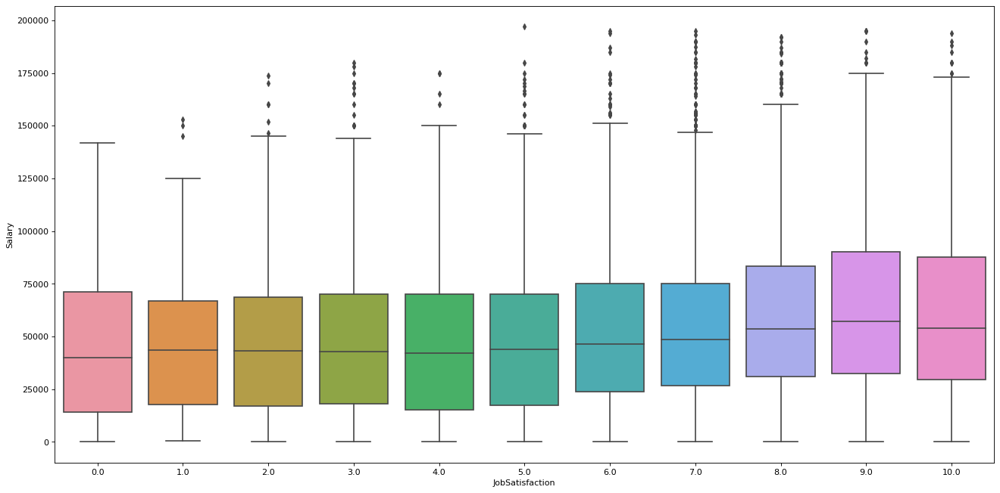

In [53]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['JobSatisfaction'], y=data['Salary'])

<AxesSubplot:xlabel='MinYearsCodedJob', ylabel='Salary'>

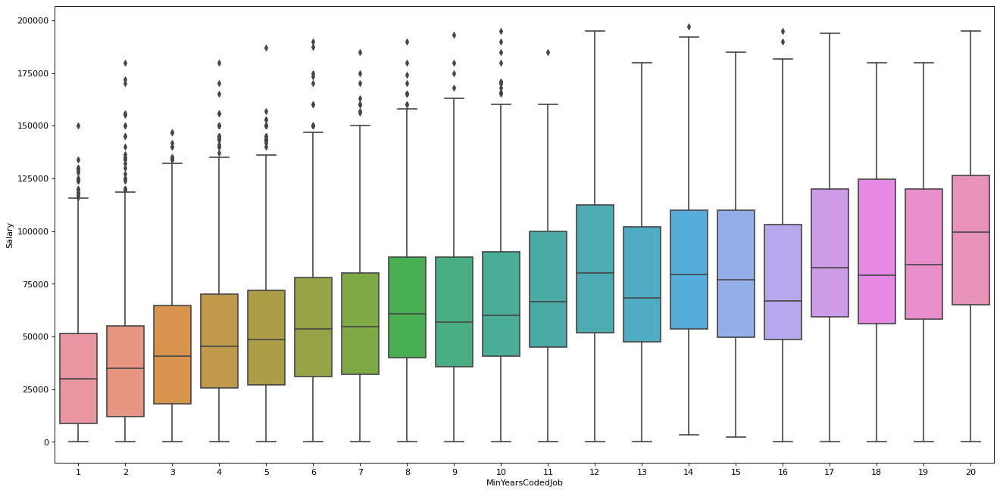

In [54]:
l = data['MinYearsCodedJob'].unique()
l = l[l != None]
l = l.astype(np.float)
l.sort()
l = ["%.2f" % number for number in l]

for i in range(len(l)):
    l[i]=l[i][:-3]

plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['MinYearsCodedJob'], y=data['Salary'], order = l)

In [25]:
pd.set_option('display.max_rows', 10)

In [26]:
data

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,CompanyType,YearsProgram,YearsCodedJob,YearsCodedJobPast,DeveloperType,WebDeveloperType,MobileDeveloperType,NonDeveloperType,CareerSatisfaction,JobSatisfaction,ExCoderReturn,ExCoderNotForMe,ExCoderBalance,ExCoder10Years,ExCoderBelonged,ExCoderSkills,ExCoderWillNotCode,ExCoderActive,PronounceGIF,ProblemSolving,BuildingThings,LearningNewTech,BoringDetails,JobSecurity,DiversityImportant,AnnoyingUI,FriendsDevelopers,RightWrongWay,UnderstandComputers,SeriousWork,InvestTimeTools,WorkPayCare,KinshipDevelopers,ChallengeMyself,CompetePeers,ChangeWorld,JobSeekingStatus,HoursPerWeek,LastNewJob,AssessJobIndustry,AssessJobRole,AssessJobExp,AssessJobDept,AssessJobTech,AssessJobProjects,AssessJobCompensation,AssessJobOffice,AssessJobCommute,AssessJobRemote,AssessJobLeaders,AssessJobProfDevel,AssessJobDiversity,AssessJobProduct,AssessJobFinances,ImportantBenefits,ClickyKeys,JobProfile,ResumePrompted,LearnedHiring,ImportantHiringAlgorithms,ImportantHiringTechExp,ImportantHiringCommunication,ImportantHiringOpenSource,ImportantHiringPMExp,ImportantHiringCompanies,ImportantHiringTitles,ImportantHiringEducation,ImportantHiringRep,ImportantHiringGettingThingsDone,Currency,Overpaid,TabsSpaces,EducationImportant,EducationTypes,SelfTaughtTypes,TimeAfterBootcamp,CousinEducation,WorkStart,HaveWorkedLanguage,WantWorkLanguage,HaveWorkedFramework,WantWorkFramework,HaveWorkedDatabase,WantWorkDatabase,HaveWorkedPlatform,WantWorkPlatform,IDE,AuditoryEnvironment,Methodology,VersionControl,CheckInCode,ShipIt,OtherPeoplesCode,ProjectManagement,EnjoyDebugging,InTheZone,DifficultCommunication,CollaborateRemote,MetricAssess,EquipmentSatisfiedMonitors,EquipmentSatisfiedCPU,EquipmentSatisfiedRAM,EquipmentSatisfiedStorage,EquipmentSatisfiedRW,InfluenceInternet,InfluenceWorkstation,InfluenceHardware,InfluenceServers,InfluenceTechStack,InfluenceDeptTech,InfluenceVizTools,InfluenceDatabase,InfluenceCloud,InfluenceConsultants,InfluenceRecruitment,InfluenceCommunication,StackOverflowDescribes,StackOverflowSatisfaction,StackOverflowDevices,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowJobListing,StackOverflowCompanyPage,StackOverflowJobSearch,StackOverflowNewQuestion,StackOverflowAnswer,StackOverflowMetaChat,StackOverflowAdsRelevant,StackOverflowAdsDistracting,StackOverflowModeration,StackOverflowCommunity,StackOverflowHelpful,StackOverflowBetter,StackOverflowWhatDo,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary,MinYearsCodedJob
0,1,Student,"Yes, both",United States,No,"Not employed, and not looking for work",Secondary school,NaN,NaN,NaN,NaN,2 to 3 years,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"With a soft ""g,"" like ""jiff""",Strongly agree,Strongly agree,Agree,Disagree,Strongly agree,Agree,Agree,Disagree,Somewhat agree,Disagree,Strongly agree,Strongly agree,Strongly disagree,Agree,Agree,Disagree,Agree,"I'm not actively looking, but I am open to new...",0.0,Not applicable/ never,Very important,Very important,Important,Very important,Very important,Very important,Important,Very important,Very important,Very important,Very important,Very important,Somewhat important,Not very important,Somewhat important,Stock options; Vacation/days off; Remote options,Yes,Other,NaN,NaN,Important,Important,Important,Somewhat important,Important,Not very important,Not very important,Not at all important,Somewhat important,Very important,NaN,NaN,Tabs,NaN,Online course; Open source contributions,NaN,NaN,NaN,6:00 AM,Swift,Swift,NaN,NaN,NaN,NaN,iOS,iOS,Atom; Xcode,Turn on some music,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Somewhat satisfied,Not very satisfied,Not at all satisfied,Very satisfied,Satisfied,Not very satisfied,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I have created a CV or Developer Story on Stac...,9.0,Desktop

In [27]:
print("shape of data:" + "\n" + str(data.shape)+ "\n" + "shape of schema:"+ "\n" + str(schema.shape))

shape of data:
(51392, 155)
shape of schema:
(154, 2)


In [28]:
data = data.dropna(how='all', axis=1)

In [29]:
schema

,Column,Question
0,Respondent,Respondent ID number
1,Professional,Which of the following best describes you?
2,ProgramHobby,Do you program as a hobby or contribute to ope...
3,Country,In which country do you currently live?
4,University,"Are you currently enrolled in a formal, degree..."
...,...,...
149,QuestionsInteresting,The questions were interesting
150,QuestionsConfusing,The questions were confusing
151,InterestedAnswers,I'm interested in learning how other developer...
152,Salary,"What is your current annual base salary, befor..."


In [30]:
#rodzaje zawodów
print(data["Professional"].unique().tolist())
print('There are {} unique Professional in the provided dataset'.format(len(data['Professional'].unique().tolist())))

['Student', 'Professional developer', 'Professional non-developer who sometimes writes code', 'Used to be a professional developer', 'None of these']
There are 5 unique Professional in the provided dataset


Text(0.5, 1.0, 'What kind of developer are you?')

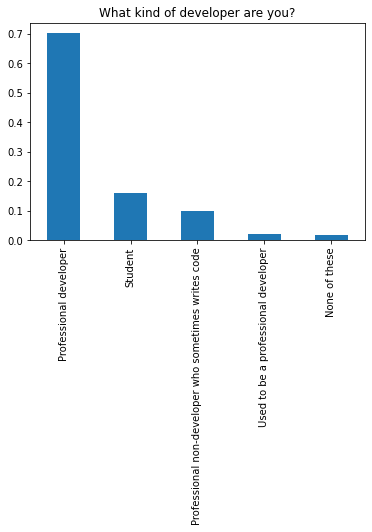

In [31]:
%matplotlib inline
professional_stats=data['Professional'].value_counts()
(professional_stats/data.shape[0]).plot(kind='bar')
plt.title("What kind of developer are you?")

In [32]:
#rodzaje edukacji
print(data['FormalEducation'].unique().tolist())

['Secondary school', "Some college/university study without earning a bachelor's degree", "Bachelor's degree", 'Doctoral degree', "Master's degree", 'Professional degree', 'Primary/elementary school', 'I prefer not to answer', 'I never completed any formal education']


Text(0.5, 1.0, 'Formal Education')

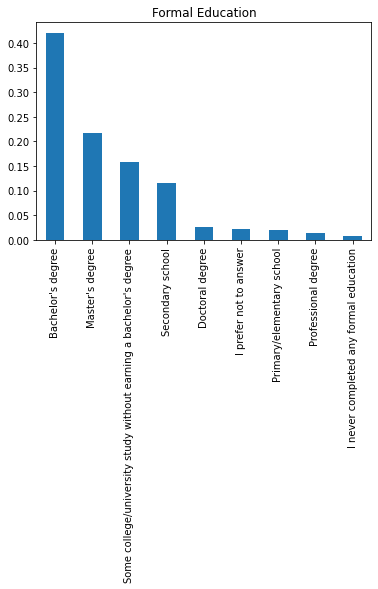

In [33]:
Formaledu_stats=data['FormalEducation'].value_counts()
(Formaledu_stats/data.shape[0]).plot(kind='bar')
plt.title("Formal Education")

In [34]:
data[cols]

,JobSatisfaction,HoursPerWeek,StackOverflowSatisfaction,Salary,ExpectedSalary
0,NaN,0.0,9.0,NaN,NaN
1,NaN,NaN,8.0,NaN,37500.0
2,9.0,NaN,8.0,113750.0,NaN
3,3.0,5.0,10.0,NaN,NaN
4,8.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...
51387,3.0,5.0,9.0,58000.0,NaN
51388,NaN,NaN,7.0,NaN,NaN
51389,10.0,NaN,NaN,NaN,NaN
51390,7.0,1.0,9.0,40000.0,NaN


In [35]:
df = data.drop(data[data.Salary.isna()].index)

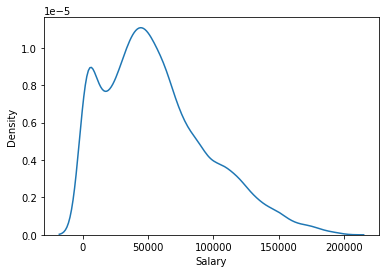

In [36]:
sns.kdeplot(data=df, x="Salary")
plt.show()

In [37]:
data.shape

(51392, 155)

In [38]:
df["ExpectedSalary"].isna().sum()

12891

In [39]:
df.shape

(12891, 155)

In [40]:
data['MinYearsCodedJob']

0        None
1        None
2          20
3           9
4          10
         ... 
51387       1
51388    None
51389    None
51390       3
51391       5
Name: MinYearsCodedJob, Length: 51392, dtype: object

In [41]:
l = [
    'FormalEducation',
    'Country',
    'Race',
    'Gender',
    'MinYearsCodedJob',
    'DeveloperType',
    'CompanySize',
    'HoursPerWeek',
    'LearningNewTech',
    'ExCoderReturn',
    'ExCoderNotForMe',
    'ExCoderBalance',
    'ExCoder10Years',
    'ExCoderBelonged',
    'ExCoderSkills',
    'ExCoderWillNotCode',
    'ExCoderActive',
    'BuildingThings',
    'BoringDetails',
    'JobSecurity',
    'DiversityImportant',
    'FriendsDevelopers',
    'CompetePeers',
    'SeriousWork',
    'CheckInCode',
    'ShipIt',
    'DifficultCommunication',
    'CollaborateRemote'
]
print(len(l))

chunk_count = 2
limit = len(l)//chunk_count
chunk1 = l[:limit]
chunk2 = l[limit:-1]
print(chunk1)
print(chunk2)
def drawboxplots(l):
    for value in l:
        plt.figure(figsize=(20,10), dpi=80)
        sns.boxplot(x=data[value], y=data['Salary'])    

28
['FormalEducation', 'Country', 'Race', 'Gender', 'MinYearsCodedJob', 'DeveloperType', 'CompanySize', 'HoursPerWeek', 'LearningNewTech', 'ExCoderReturn', 'ExCoderNotForMe', 'ExCoderBalance', 'ExCoder10Years', 'ExCoderBelonged']
['ExCoderSkills', 'ExCoderWillNotCode', 'ExCoderActive', 'BuildingThings', 'BoringDetails', 'JobSecurity', 'DiversityImportant', 'FriendsDevelopers', 'CompetePeers', 'SeriousWork', 'CheckInCode', 'ShipIt', 'DifficultCommunication']


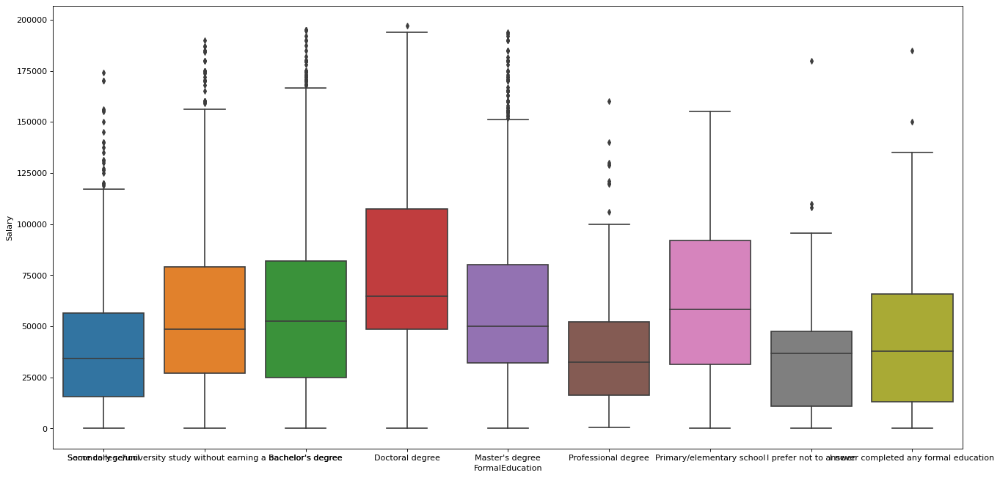

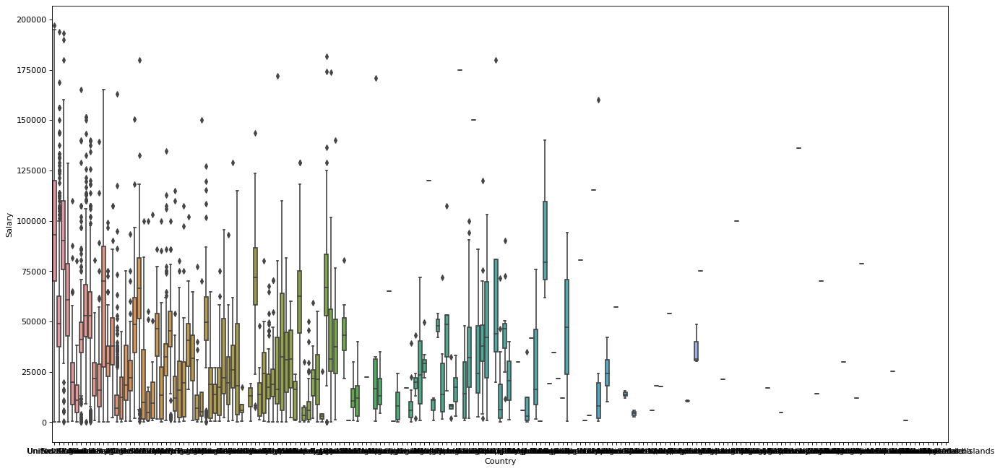

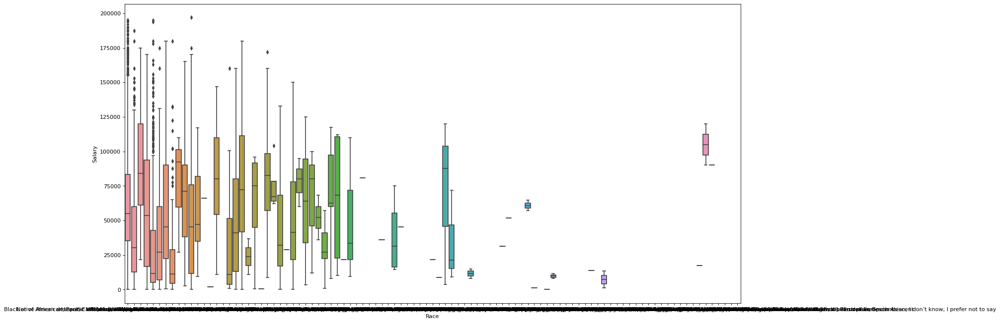

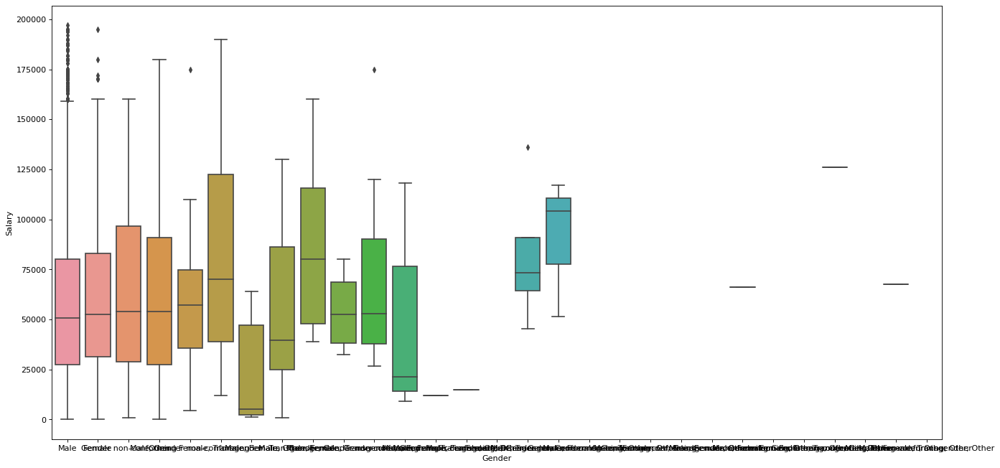

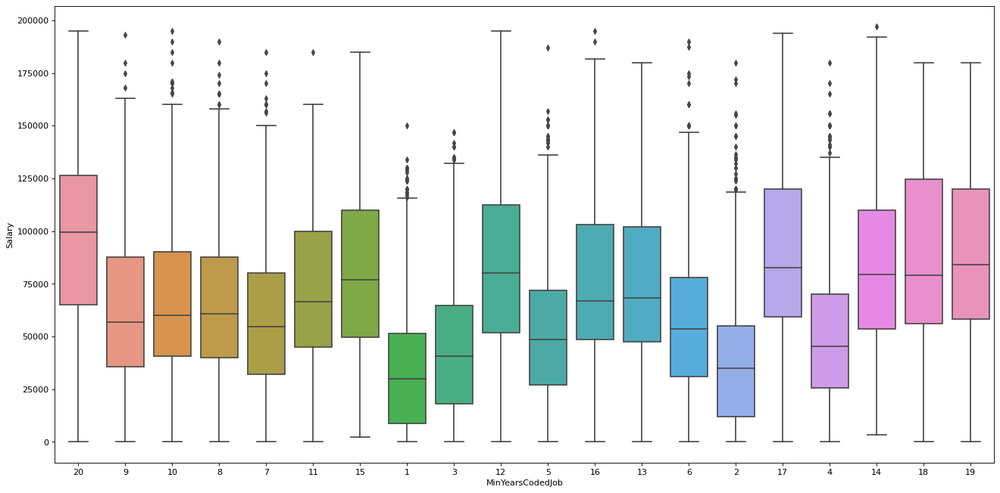

...

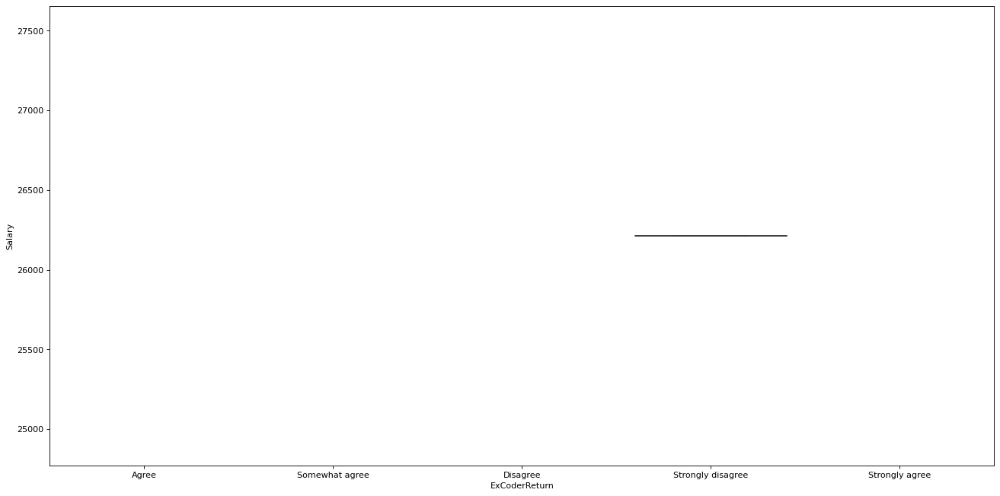

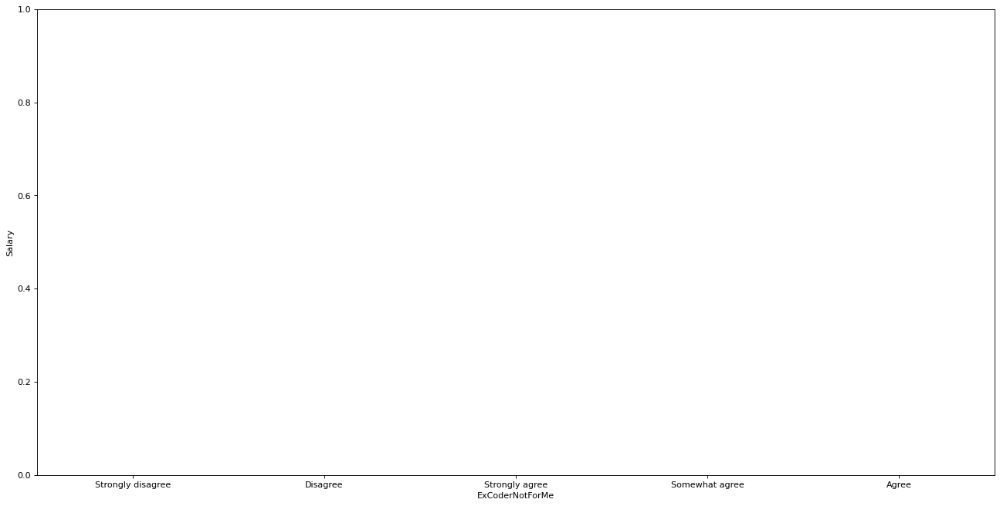

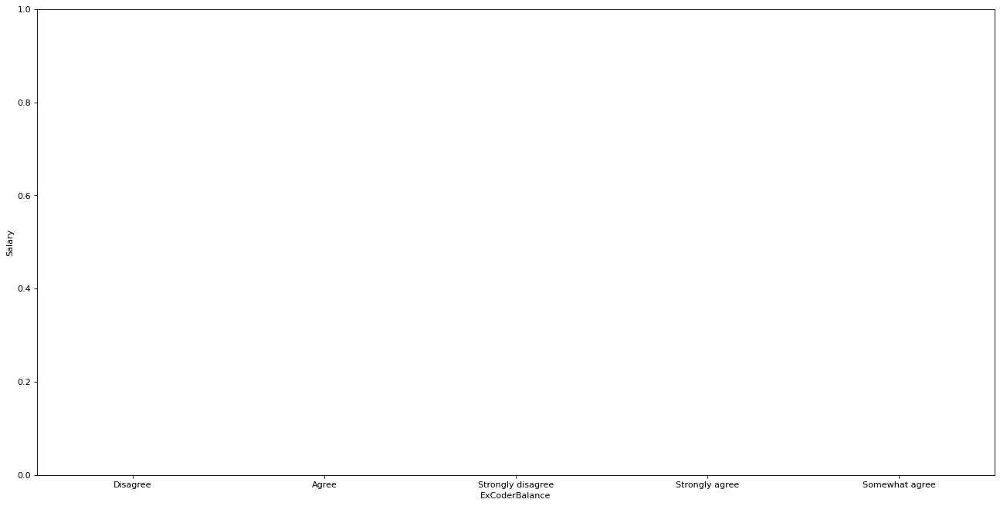

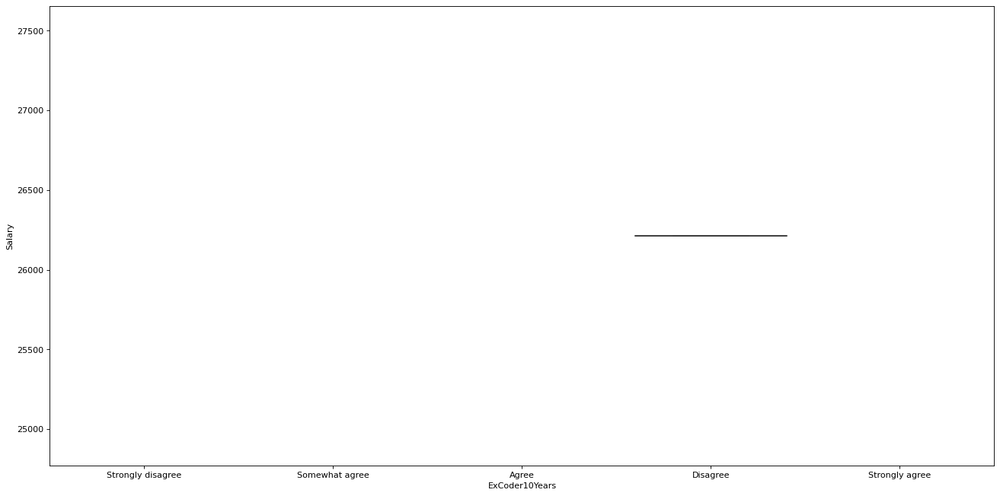

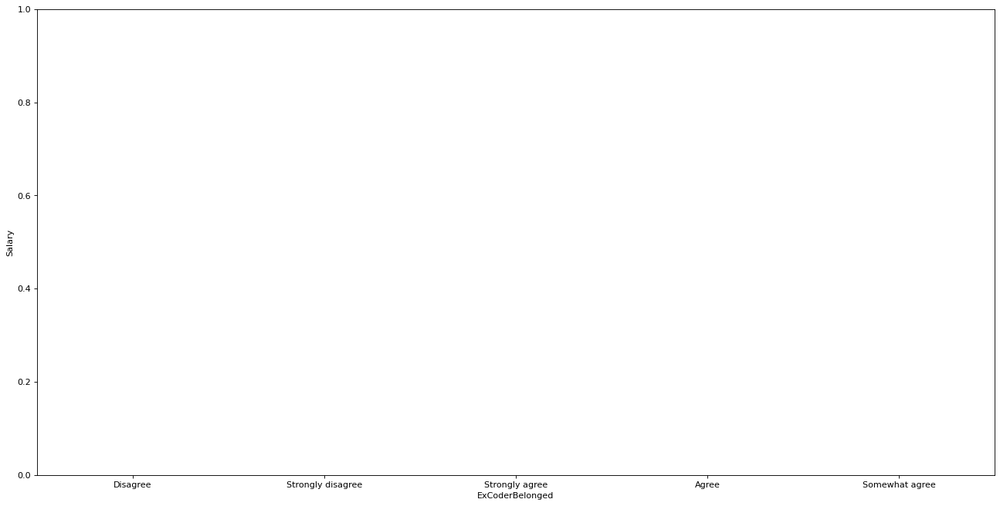

In [42]:
drawboxplots(chunk1)

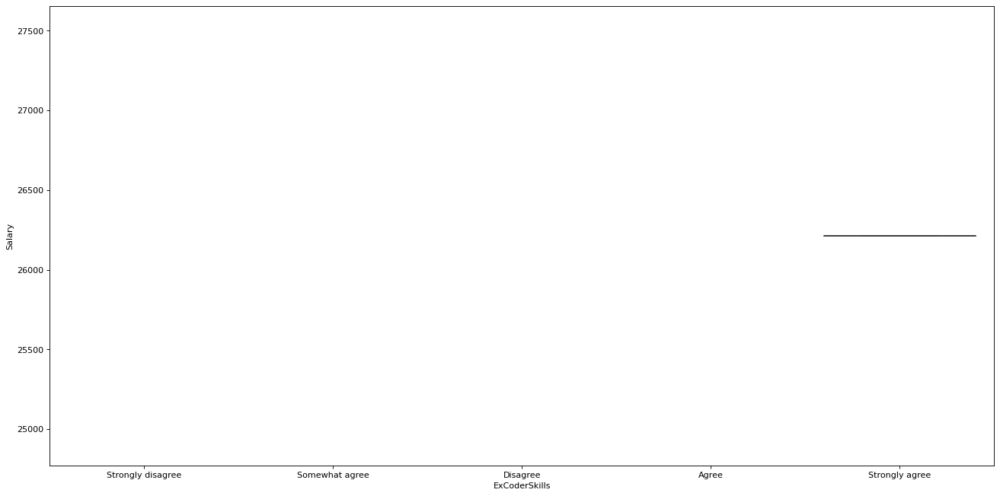

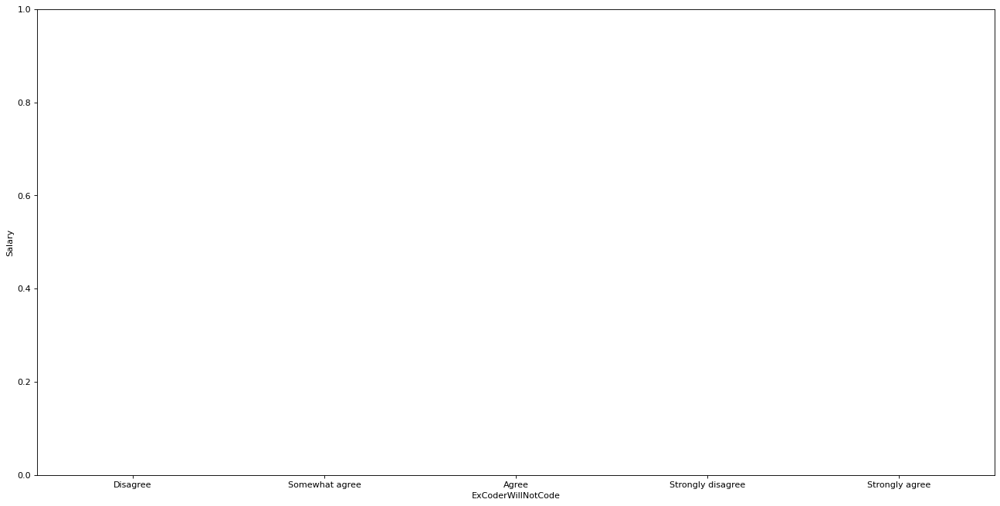

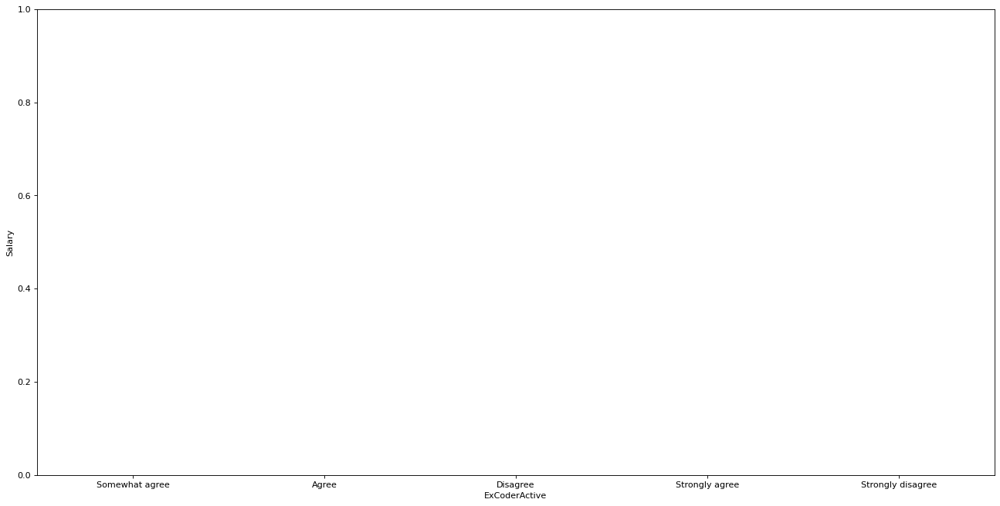

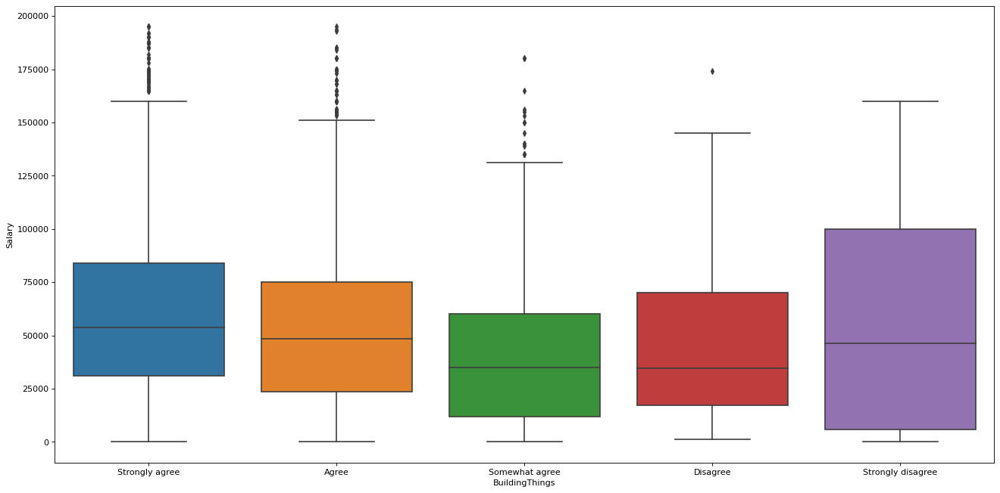

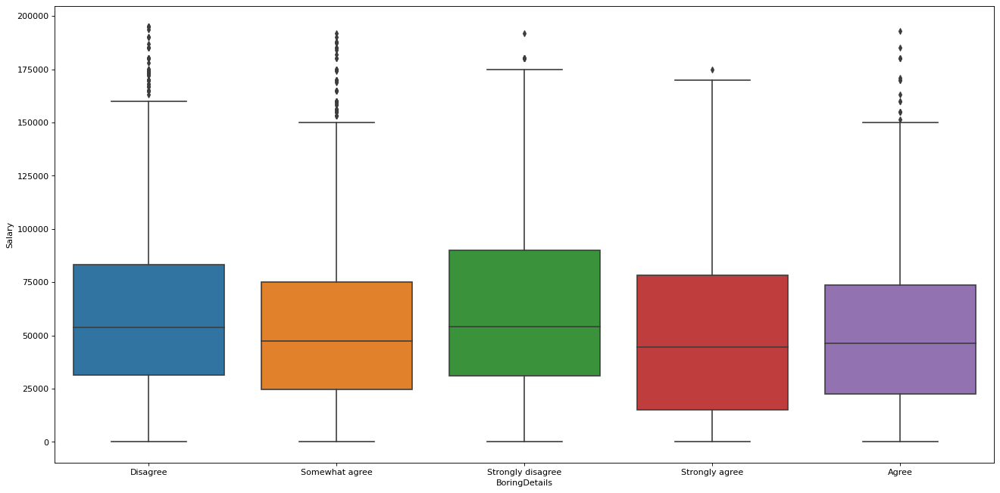

...

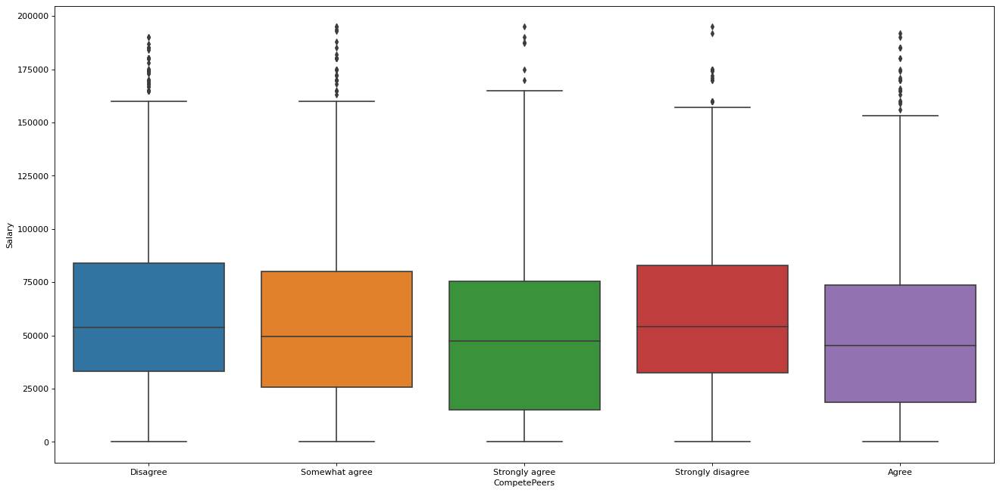

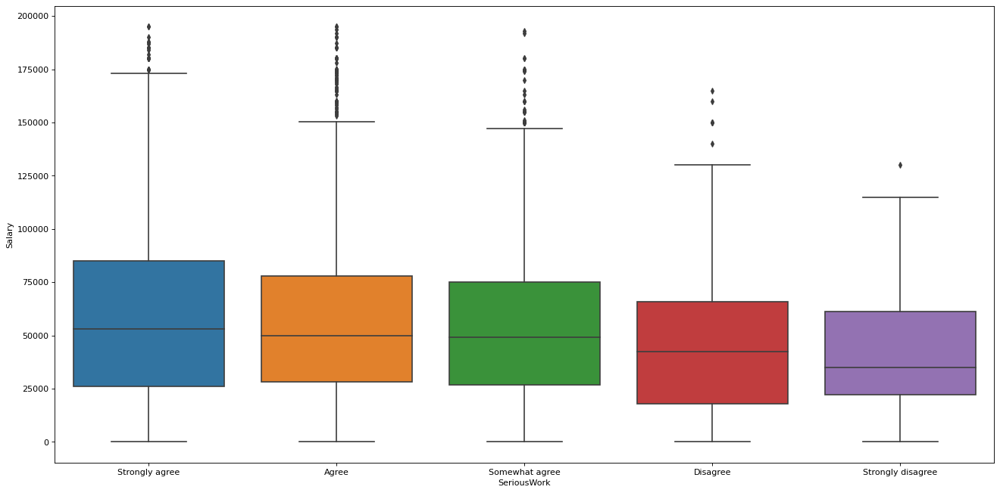

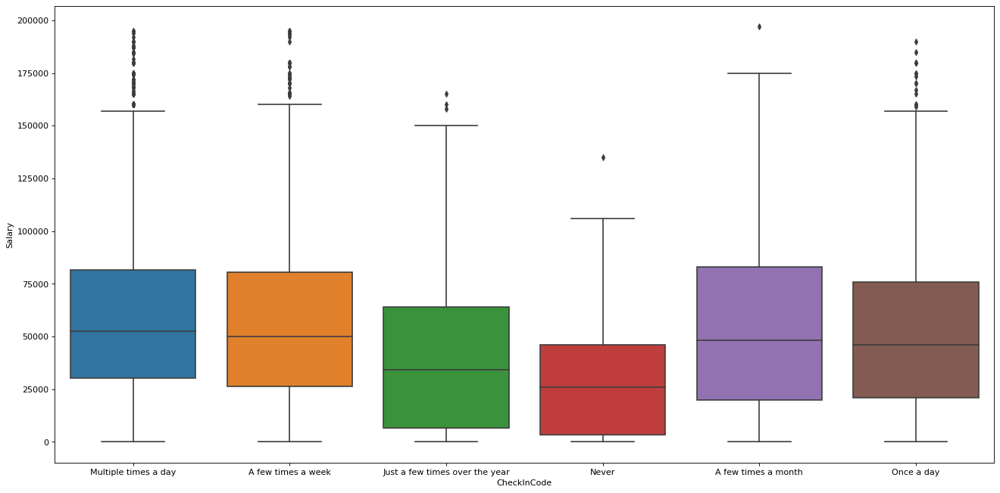

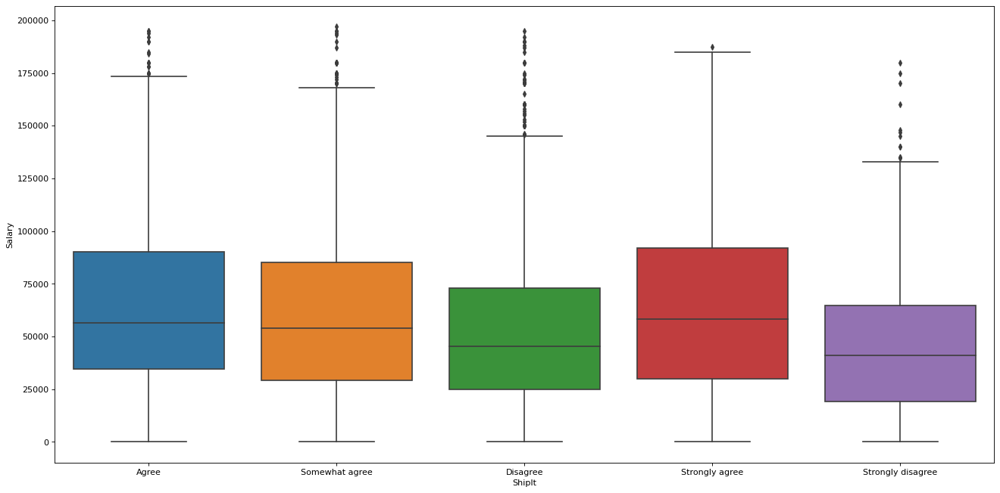

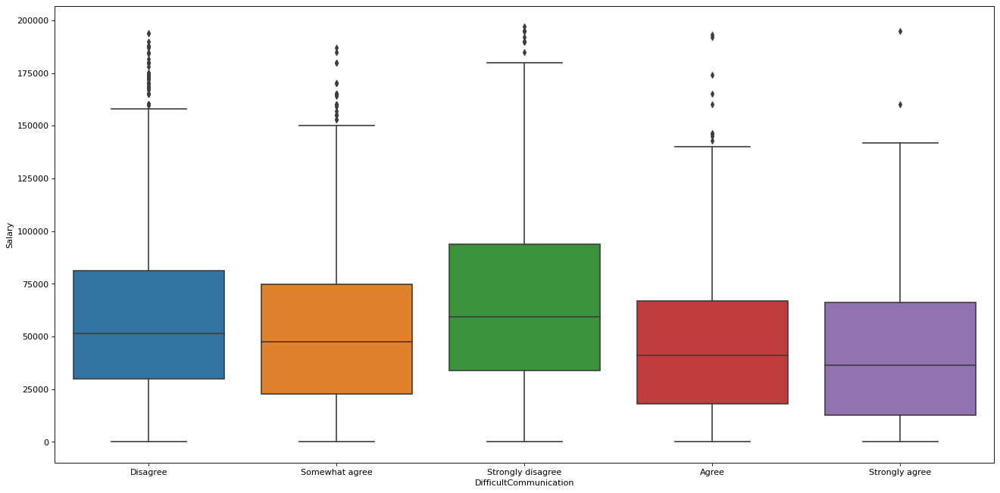

In [43]:
drawboxplots(chunk2)

<AxesSubplot:ylabel='Country'>

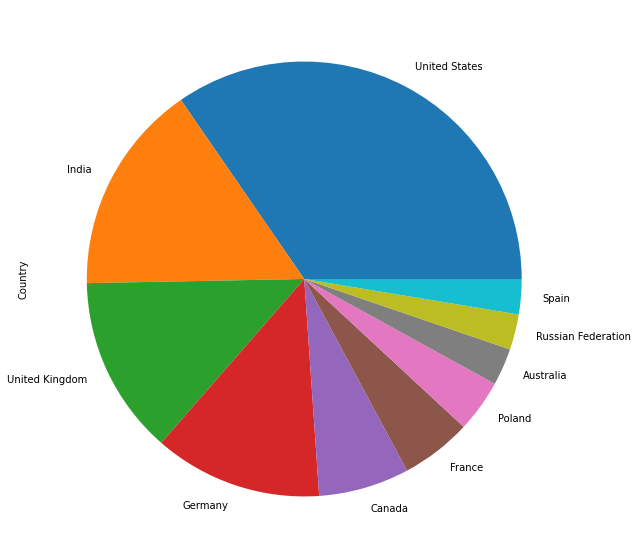

In [44]:
data['Country'].value_counts()[0:10].plot(kind='pie',figsize=(12,10))

<AxesSubplot:ylabel='Gender'>

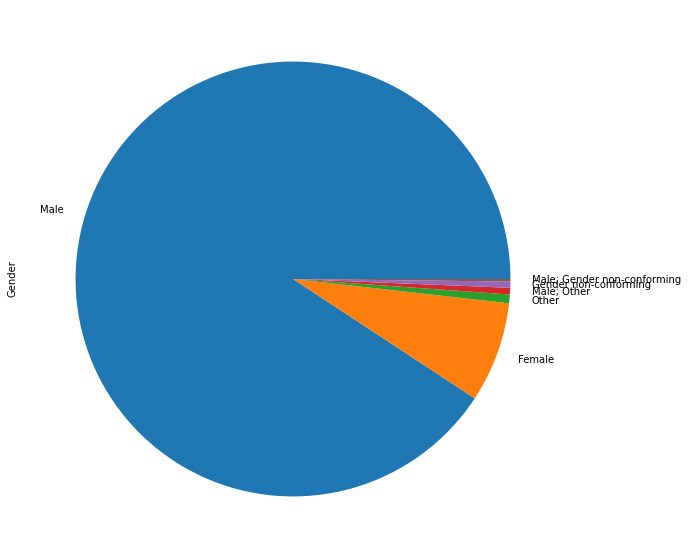

In [45]:
data['Gender'].value_counts()[0:6].plot(kind='pie',figsize=(12,10))

<AxesSubplot:ylabel='Race'>

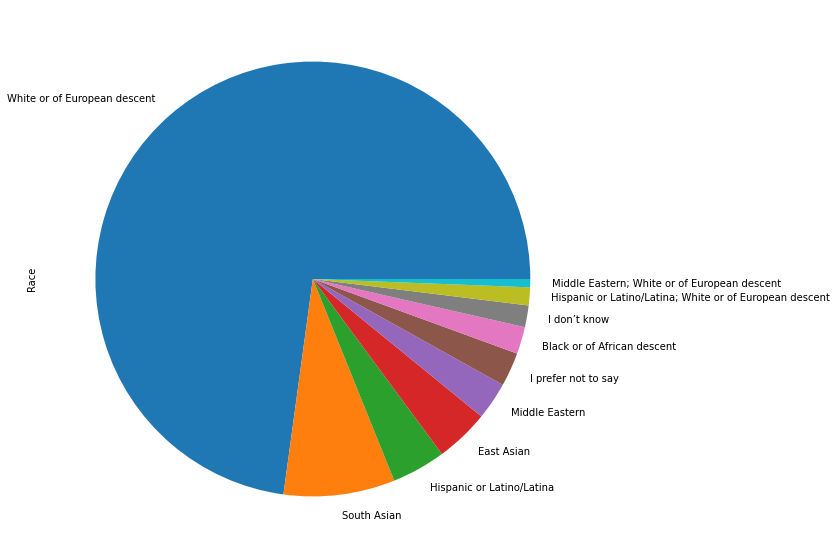

In [46]:
data['Race'].value_counts()[0:10].plot(kind='pie',figsize=(12,10))

<AxesSubplot:ylabel='DeveloperType'>

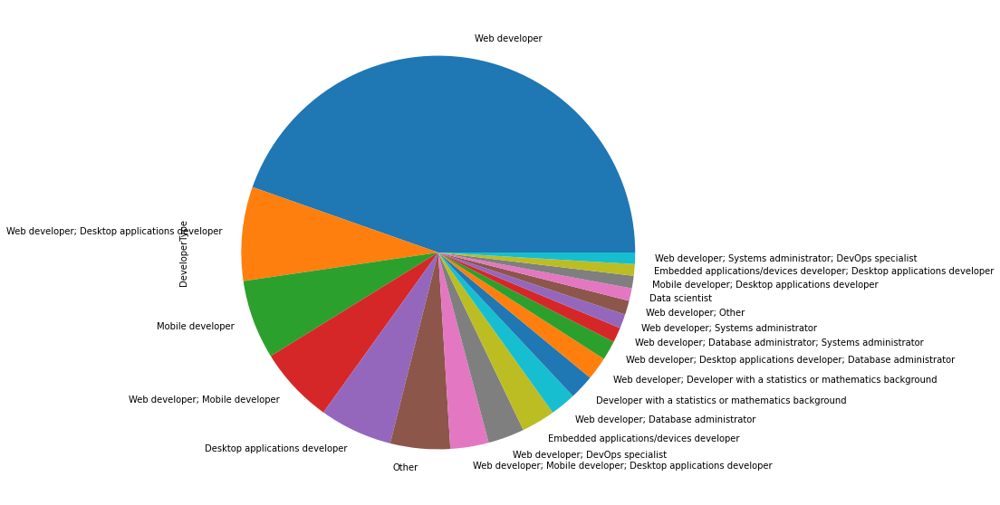

In [47]:
data['DeveloperType'].value_counts()[0:20].plot(kind='pie',figsize=(12,10))